In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
import seaborn as sns
sns.set_context("paper")
sns.set_style("ticks")

# Uncomment the next two lines if running for the book
import warnings
warnings.filterwarnings("ignore")

from functools import partial
import jax
from jax import tree, vmap, jit, grad, value_and_grad
import jax.numpy as jnp
import jax.random as jr
from jax.flatten_util import ravel_pytree
from tinygp import GaussianProcess, kernels, transforms
import equinox as eqx
import optax
from jax.scipy.optimize import minimize
import scipy.stats.qmc as qmc
import numpy as np
from typing import NamedTuple

jax.config.update("jax_enable_x64", True)
np.random.seed(0)
key = jr.PRNGKey(np.random.randint(0, 10000))

# Uncertainty Sampling Example

We will do uncertainty sampling (i.e., active learning with the expected information gain objective) to create the best model with the least amount of data.

## 1D example

Here is the data-generating process. (Yes, it's just a simple python function. But pretend it's something much more expensive to evaluate, like a physical experiment or a complex simulation.)

In [2]:
def data_generating_process_1d(x):
    """Stand-in for an expensive simulator or physical experiment."""
    x = x[0]  # Unpack the 1D array
    return np.sin(10*x**2) + x + 0.1*np.random.normal(size=x.shape)

Start with just one data point:

In [3]:
X_1d = jr.uniform(key, (1, 1))
y_1d = data_generating_process_1d(X_1d)

It is not a good idea to train the model when we have so few data. 
So, we will simply fix the hyperparameters of the GP to something reasonable.

In [4]:
def build_gp(params, X):
    """Build a 1D Gaussian process with RBF kernel."""
    k = params['amplitude']*kernels.ExpSquared(params['lengthscale'])
    return GaussianProcess(k, X, diag=params['noise_stdev']**2, mean=params['mean'])

params = {
    'mean': 0.0,
    'amplitude': 4.0,
    'lengthscale': 0.15,
    'noise_stdev': 0.1
}

def eval_gp(Xq, X, y, params):
    gp = build_gp(params, X)
    _, cond_gp = gp.condition(y, Xq)
    return cond_gp

Xq_plt = jnp.linspace(0, 1, 1000)[:, None]
cond_gp = eval_gp(Xq_plt, X_1d, y_1d, params)

And let's visualize the uncertainty in the model's prediction:

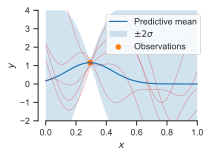

In [5]:
def plot_posterior_uncertainty_1d(X, y, params, ax=None, legend=True):
    X_pred = jnp.linspace(0, 1, 100)[:, None]
    cond_gp = eval_gp(X_pred, X, y, params)
    mean = cond_gp.mean
    std = jnp.sqrt(cond_gp.variance)
    samples = cond_gp.sample(key, shape=(5,))
    if ax is None:
        fig, ax = plt.subplots(figsize=(3, 2))
    ax.plot(X_pred, mean, label="Predictive mean" if legend else None)
    ax.fill_between(X_pred.squeeze(), mean - 2*std, mean + 2*std, alpha=0.2, label=r"$\pm 2\sigma$" if legend else None)
    ax.scatter(X, y, label="Observations" if legend else None)
    ax.plot(X_pred, samples.T, color='tab:red', lw=0.5, alpha=0.5)
    if legend:
        # ax.legend(loc='upper right')
        ax.legend(loc='best')
    ax.set_ylim(-2.0, 4.0)
    ax.set_xlabel(r"$x$")
    ax.set_ylabel(r"$y$")
    sns.despine(trim=True)
    return ax

plot_posterior_uncertainty_1d(X_1d, y_1d, params);

Uncertainty is lower near the data point and high everywhere else.
Let's find the "best" next point to evaluate. 
Since our goal is to create the "best" model, we'll select the point where there is maximum predictive uncertainty.

In [6]:
def get_next_x(X_obs, y_obs, params, n_start=1000):
    """Gets the next input x to evaluate. It does this by doing a random search to find the point of maximum predictive uncertainty."""
    Xs = qmc.LatinHypercube(X_obs.shape[1]).random(n=n_start)
    variances = eval_gp(Xs, X_obs, y_obs, params).variance.squeeze()
    next_x = Xs[jnp.argmax(variances)]
    return next_x

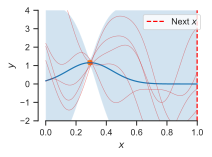

In [7]:
next_x = get_next_x(X_1d, y_1d, params)
ax = plot_posterior_uncertainty_1d(X_1d, y_1d, params, legend=False)
ax.axvline(next_x, color="red", linestyle="--", label=r"Next $x$")
ax.legend(loc='upper right');

The "best" point is near the boundary. Let's generate a data value at this point and plot a new fitted GP:

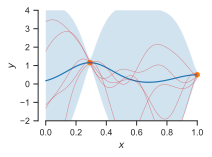

In [8]:
key, key_data, key_train = jr.split(key, 3)
next_y = data_generating_process_1d(next_x)
X_1d = jnp.concatenate([X_1d, next_x[None, :]], axis=0)
y_1d = jnp.concatenate([y_1d, next_y[None]], axis=0)

ax = plot_posterior_uncertainty_1d(X_1d, y_1d, params, legend=False)

Let's repeat this process a few more times:

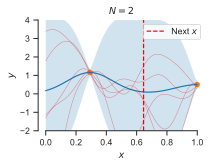

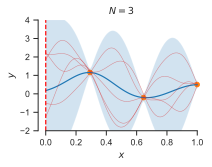

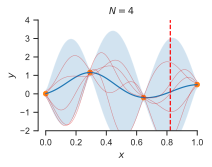

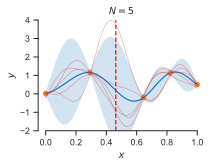

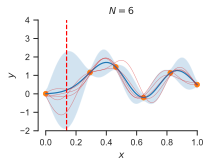

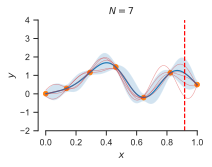

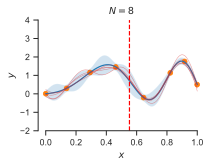

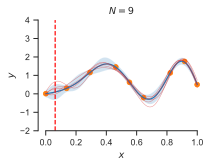

In [9]:
for i in range(8):
    next_x = get_next_x(X_1d, y_1d, params)
    ax = plot_posterior_uncertainty_1d(X_1d, y_1d, params, legend=False)
    ax.axvline(next_x, color="red", linestyle="--", label=r"Next $x$")
    ax.set_title(f"$N={X_1d.shape[0]}$")
    if i == 0:
        ax.legend(loc='upper right')
    key, key_data, key_train = jr.split(key, 3)
    next_y = data_generating_process_1d(next_x)
    X_1d = jnp.concatenate([X_1d, next_x[None, :]], axis=0)
    y_1d = jnp.concatenate([y_1d, next_y[None]], axis=0)

In a realistic scenario, we would keep going until the epistemic uncertainty is low enough or we run out of computational budget.

## 2D example

Let's do the same thing in 2D. The data-generating process is:

In [10]:
@jit
def data_generating_process_2d(x):
    """Stand-in for an expensive simulator or physical experiment."""
    x1, x2 = x[0], x[1]
    f1 = 1/2*jnp.sin(5/2*x1 + 2/3*x2)**2 + 2/3*jnp.exp(-x1*(x2 - 0.5)**2)*jnp.cos(4*x1 + x2)**2
    f2 = x1*(1 - x1)*x2*(1 - x2)*10
    alpha = jax.nn.sigmoid(10*(x2 - x1))
    return alpha*f1 + (1 - alpha)*f2

Again, pretend `data_generating_process_2d` is actually some expensive process. 

Let's start with a few data points:

In [11]:
X_2d = qmc.LatinHypercube(d=2).random(n=5)
y_2d = vmap(data_generating_process_2d)(X_2d)

Build a GP:

In [ ]:
def build_gp(params, X):
    """Build a 2D Gaussian process with RBF kernel."""
    amp = params['amplitude']
    ell = params['lengthscales']
    sigma = params['noise_stdev']
    k = amp*transforms.Linear(1/ell, kernels.ExpSquared())  # Must be constructed this way if ell is a vector
    return GaussianProcess(k, X, diag=sigma**2, mean=params['mean'])

# Fixed hyperparameters
params = {
    'mean': 0.0,
    'amplitude': 4.0,
    'lengthscales': jnp.array([0.3, 0.3]),  # Set these to different values for an anisotropic GP
    'noise_stdev': 0.01
}

def eval_gp(Xq, X, y, params):
    gp = build_gp(params, X)
    _, cond_gp = gp.condition(y, Xq)
    return cond_gp

X1, X2 = jnp.meshgrid(jnp.linspace(0, 1, 30), jnp.linspace(0, 1, 30))
Xq_plt = jnp.stack([X1.ravel(), X2.ravel()], axis=1)
cond_gp = eval_gp(Xq_plt, X_2d, y_2d, params)

Find the best next point at which to collect data:

In [13]:
next_x = get_next_x(X_2d, y_2d, params)

And plot:

In [14]:
def plot_posterior_uncertainty_2d(X, y, params, unc_clim=None):
    X1_plt, X2_plt = jnp.meshgrid(jnp.linspace(0, 1, 50), jnp.linspace(0, 1, 50))
    X_plt = jnp.stack([X1_plt.ravel(), X2_plt.ravel()], axis=1)
    
    fig, ax = plt.subplots(1, 3, figsize=(9, 3), sharex=True, sharey=True)

    # Ground truth
    Y_gt_plt = vmap(data_generating_process_2d)(X_plt).reshape(X1_plt.shape)
    p = ax[0].pcolormesh(X1_plt, X2_plt, Y_gt_plt, cmap="viridis")
    p.set_edgecolor('face')
    ax[0].set_aspect("equal")
    ax[0].set_title("Ground truth", fontsize=12)

    # Evaluate GP on a grid
    cond_gp = eval_gp(X_plt, X=X, y=y, params=params)
    Y_mean_plt = cond_gp.mean.reshape(X1_plt.shape)
    Y_variance_plt = cond_gp.variance.reshape(X1_plt.shape)

    # Plot the mean
    p = ax[1].pcolormesh(X1_plt, X2_plt, Y_mean_plt, cmap="viridis", vmin=p.get_clim()[0], vmax=p.get_clim()[1])
    p.set_edgecolor('face')
    ax[1].scatter(X[:,0], X[:,1], color="C1", label="Observation")
    ax[1].set_aspect("equal")
    ax[1].set_title("GP mean", fontsize=12)

    # Plot the variance
    p = ax[2].pcolormesh(X1_plt, X2_plt, Y_variance_plt, cmap="viridis", vmin=unc_clim[0] if unc_clim is not None else None, vmax=unc_clim[1] if unc_clim is not None else None)
    p.set_edgecolor('face')
    ax[2].scatter(X[:,0], X[:,1], color="C1", label="Observation")
    ax[2].set_aspect("equal")
    ax[2].set_xticks([0, 0.5, 1])
    ax[2].set_yticks([0, 0.5, 1])
    ax[2].set_title("GP variance", fontsize=12)

    sns.despine(trim=True, left=True, bottom=True)
    return ax, p.get_clim()

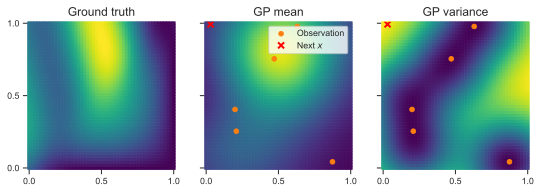

In [15]:
ax, unc_clim = plot_posterior_uncertainty_2d(X_2d, y_2d, params)
ax[1].plot(next_x[0], next_x[1], "rx", ms=6, mew=2, label="Next $x$")
ax[2].plot(next_x[0], next_x[1], "rx", ms=6, mew=2, label="Next $x$")
ax[1].legend(loc='upper right');

The highest uncertainty is at the edge of the domain, so that is where the next best point is.

Let's do a few more iterations of active learning:

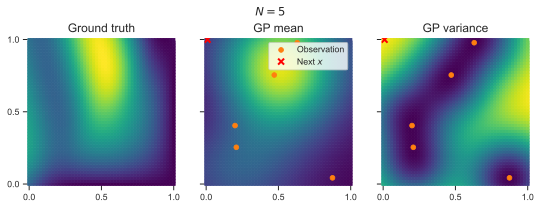

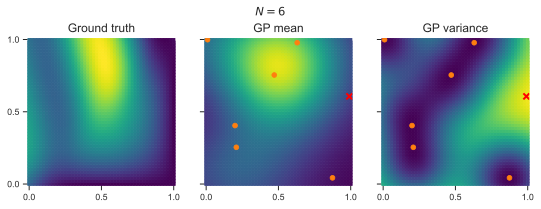

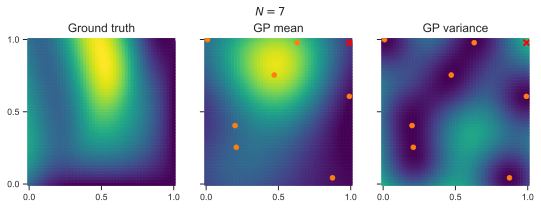

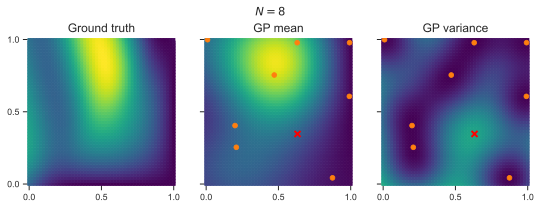

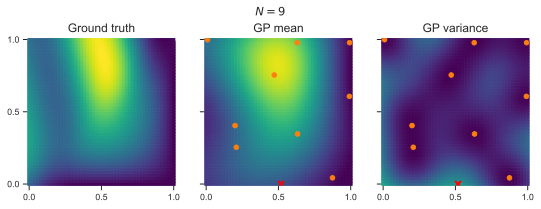

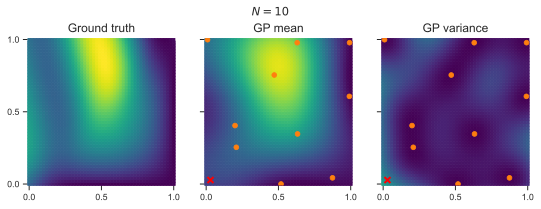

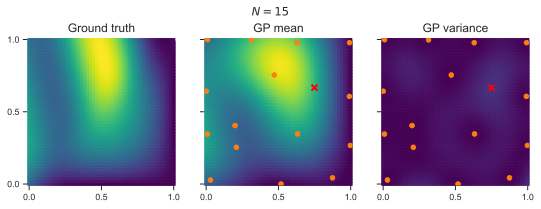

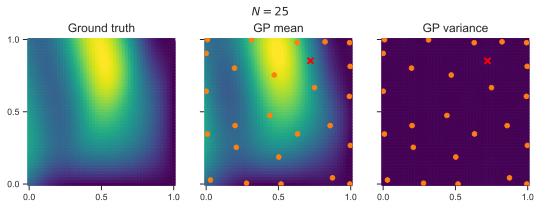

In [16]:
plot_iter = [0, 1, 2, 3, 4, 5, 10, 20]
for i in range(plot_iter[-1] + 1):
    next_x = get_next_x(X_2d, y_2d, params)
    
    if i in plot_iter:
        ax, _ = plot_posterior_uncertainty_2d(X_2d, y_2d, params, unc_clim=unc_clim)
        ax[1].plot(next_x[0], next_x[1], "rx", ms=6, mew=2, label="Next $x$")
        ax[2].plot(next_x[0], next_x[1], "rx", ms=6, mew=2, label="Next $x$")
        ax[0].get_figure().suptitle(f"$N={X_2d.shape[0]}$")
        if i == 0:
            ax[1].legend(loc='upper right')

    key, key_data, key_train = jr.split(key, 3)
    next_y = data_generating_process_2d(next_x)
    X_2d = jnp.concatenate([X_2d, next_x[None, :]], axis=0)
    y_2d = jnp.concatenate([y_2d, next_y[None]], axis=0)

We have created a model in an optimally efficient manner (in terms of reducing epistemic uncertainty).

<!-- Again, most of the new points are at the boundary. 
This will be even truer in higher dimensions.
If that is not desirable, then we may need a different information acquisition function (i.e., one that reflects the fact that we value reducing uncertainty in the middle of the domain more than at the edges). -->